In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import numpy as np

In [2]:
# Load the dataset
col = ['age', 'workclass', 'fnlwgt', 'education', 'education_num', 'marital_status', 'occupation', 
       'relationship', 'race', 'sex', 'captial_gain', 'captial_loss', 'hours_per_week', 'native_country', 
       'target']

df = pd.read_csv('adult.data', index_col=None, header=None, names=col)
df

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,captial_gain,captial_loss,hours_per_week,native_country,target
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
32557,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
32558,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
32559,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


In [65]:
# Check some statistical details for each column
df.describe(include='all')

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,captial_gain,captial_loss,hours_per_week,native_country,target
count,32561.000000,32561,3.256100e+04,32561,32561.000000,32561,32561,32561,32561,32561,32561.000000,32561.000000,32561.000000,32561,32561
unique,NaN,9,NaN,16,NaN,7,15,6,5,2,NaN,NaN,NaN,42,2
top,NaN,Private,NaN,HS-grad,NaN,Married-civ-spouse,Prof-specialty,Husband,White,Male,NaN,NaN,NaN,United-States,<=50K
freq,NaN,22696,NaN,10501,NaN,14976,4140,13193,27816,21790,NaN,NaN,NaN,29170,24720
mean,38.581647,NaN,1.897784e+05,NaN,10.080679,NaN,NaN,NaN,NaN,NaN,1077.648844,87.303830,40.437456,NaN,NaN
std,13.640433,NaN,1.055500e+05,NaN,2.572720,NaN,NaN,NaN,NaN,NaN,7385.292085,402.960219,12.347429,NaN,NaN
min,17.000000,NaN,1.228500e+04,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,1.000000,NaN,NaN
25%,28.000000,NaN,1.178270e+05,NaN,9.000000,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,40.000000,NaN,NaN
50%,37.000000,NaN,1.783560e+05,NaN,10.000000,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,40.000000,NaN,NaN
75%,48.000000,NaN,2.370510e+05,NaN,12.000000,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,45.000000,NaN,NaN


Seem there are outliers in captial_gain and captial_loss. Handle it in later stage. 

In [66]:
# Verify if there is any missing value in each column
df.isnull().sum()

age               0
workclass         0
fnlwgt            0
education         0
education_num     0
marital_status    0
occupation        0
relationship      0
race              0
sex               0
captial_gain      0
captial_loss      0
hours_per_week    0
native_country    0
target            0
dtype: int64

In [47]:
# Checking if there is any duplicated entry for the whole dataset
df.duplicated().sum()

24

In [3]:
# Remove the duplicated rows
df.drop_duplicates(inplace=True)
df.shape

(32537, 15)

## Feature exploration

### Workclass

 Private             22673
 Self-emp-not-inc     2540
 Local-gov            2093
 ?                    1836
 State-gov            1298
 Self-emp-inc         1116
 Federal-gov           960
 Without-pay            14
 Never-worked            7
Name: workclass, dtype: int64


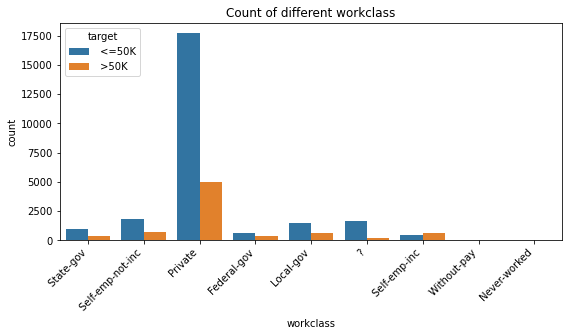

In [35]:
print(df['workclass'].value_counts())

fig, ax = plt.subplots(figsize=(9,4))
sns.countplot(x=df['workclass'], hue=df['target'])
plt.xticks(rotation=45, ha='right')
plt.title('Count of different workclass')
plt.show()

In [22]:
# Removing the leading blankspace for each data. 
# For unknown data, they will not be used in model training. Assign a null value to them and remove it later. 
df['workclass'] = df['workclass'].apply(lambda x: np.nan if x==' ?' else x[1:])

### Education

 HS-grad         10494
 Some-college     7282
 Bachelors        5353
 Masters          1722
 Assoc-voc        1382
 11th             1175
 Assoc-acdm       1067
 10th              933
 7th-8th           645
 Prof-school       576
 9th               514
 12th              433
 Doctorate         413
 5th-6th           332
 1st-4th           166
 Preschool          50
Name: education, dtype: int64


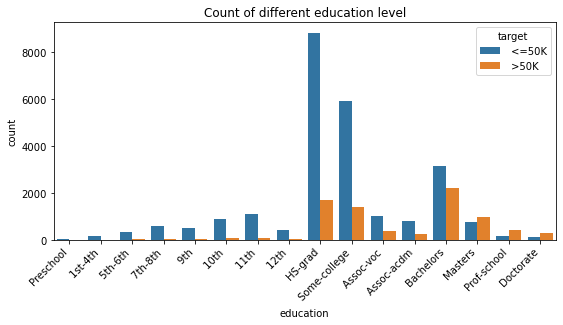

In [37]:
print(df['education'].value_counts())

edu = [' Preschool', ' 1st-4th', ' 5th-6th', ' 7th-8th', ' 9th', ' 10th', ' 11th', ' 12th', ' HS-grad', 
      ' Some-college', ' Assoc-voc', ' Assoc-acdm', ' Bachelors', ' Masters', ' Prof-school', ' Doctorate']

fig, ax = plt.subplots(figsize=(9,4))
sns.countplot(x=df['education'], hue=df['target'], order=edu)
plt.xticks(rotation=45, ha='right')
plt.title('Count of different education level')
plt.show()

Seems columns 'education' and 'education_num' are corelated. Let's check.

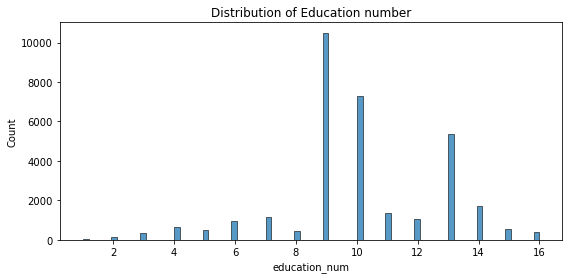

In [38]:
# From the histogram, education_num consists of 16 discrete integers

fig, ax = plt.subplots(figsize=(9,4))
sns.histplot(df['education_num'])
plt.title('Distribution of Education number')
plt.show()

In [74]:
# And from this result, each education has its own unique education_num
for x in df['education'].unique():
    print(x, df[df['education']==x]['education_num'].unique())

 Bachelors [13]
 HS-grad [9]
 11th [7]
 Masters [14]
 9th [5]
 Some-college [10]
 Assoc-acdm [12]
 Assoc-voc [11]
 7th-8th [4]
 Doctorate [16]
 Prof-school [15]
 5th-6th [3]
 10th [6]
 1st-4th [2]
 Preschool [1]
 12th [8]


In [23]:
# education & education_num are representing the same information, in category and in discrete integers respectively. 
# Drop education column to avoid multicollinearity
df.drop('education', axis=1, inplace=True)

### Marital status and Relationship

 Married-civ-spouse       14970
 Never-married            10667
 Divorced                  4441
 Separated                 1025
 Widowed                    993
 Married-spouse-absent      418
 Married-AF-spouse           23
Name: marital_status, dtype: int64


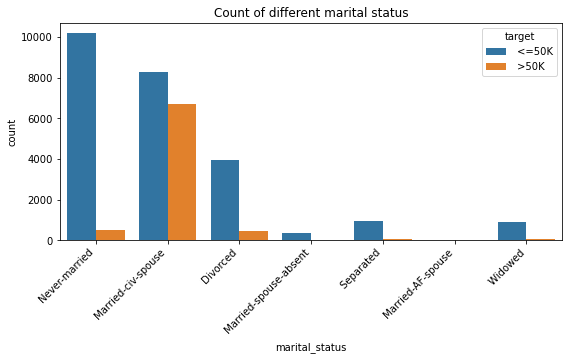

In [39]:
print(df['marital_status'].value_counts())

fig, ax = plt.subplots(figsize=(9,4))
sns.countplot(x=df['marital_status'], hue=df['target'])
plt.xticks(rotation=45, ha='right')
plt.title('Count of different marital status')
plt.show()

In [24]:
# Remove the leading blankspace
print(df['marital_status'].unique(), '\n')

df['marital_status'] = df['marital_status'].apply(lambda x:x[1:])
print(df['marital_status'].unique())

[' Never-married' ' Married-civ-spouse' ' Divorced'
 ' Married-spouse-absent' ' Separated' ' Married-AF-spouse' ' Widowed'] 

['Never-married' 'Married-civ-spouse' 'Divorced' 'Married-spouse-absent'
 'Separated' 'Married-AF-spouse' 'Widowed']


 Husband           13187
 Not-in-family      8292
 Own-child          5064
 Unmarried          3445
 Wife               1568
 Other-relative      981
Name: relationship, dtype: int64


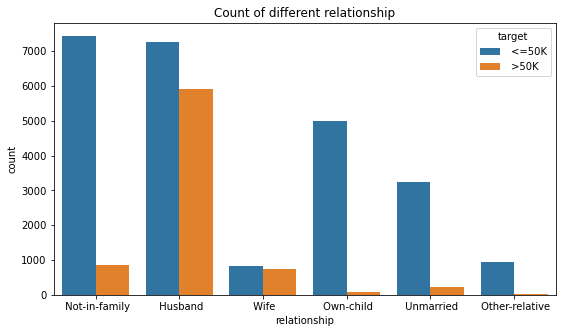

In [63]:
print(df['relationship'].value_counts())

fig, ax = plt.subplots(figsize=(9,5))
sns.countplot(x=df['relationship'], hue=df['target'])
plt.title('Count of different relationship')
plt.show()

In [25]:
# Since relationship is closely related to marital_status
# Drop relationship column to avoid multicollinearity
df.drop('relationship', axis=1, inplace=True)

### Occupation

 Prof-specialty       4136
 Craft-repair         4094
 Exec-managerial      4065
 Adm-clerical         3768
 Sales                3650
 Other-service        3291
 Machine-op-inspct    2000
 ?                    1843
 Transport-moving     1597
 Handlers-cleaners    1369
 Farming-fishing       992
 Tech-support          927
 Protective-serv       649
 Priv-house-serv       147
 Armed-Forces            9
Name: occupation, dtype: int64


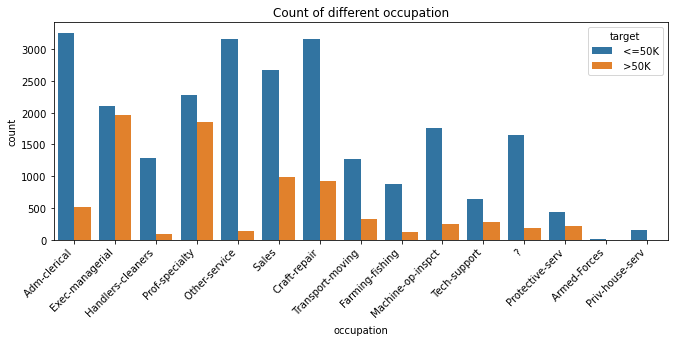

In [42]:
print(df['occupation'].value_counts())

fig, ax = plt.subplots(figsize=(11,4))
sns.countplot(x=df['occupation'], hue=df['target'])
plt.xticks(rotation=45, ha='right')
plt.title('Count of different occupation')
plt.show()

In [26]:
# Remove the leading blankspace
print(df['occupation'].unique(), '\n')

df['occupation'] = df['occupation'].apply(lambda x: np.nan if x==" ?" else x[1:])
print(df['occupation'].unique())

[' Adm-clerical' ' Exec-managerial' ' Handlers-cleaners' ' Prof-specialty'
 ' Other-service' ' Sales' ' Craft-repair' ' Transport-moving'
 ' Farming-fishing' ' Machine-op-inspct' ' Tech-support' ' ?'
 ' Protective-serv' ' Armed-Forces' ' Priv-house-serv'] 

['Adm-clerical' 'Exec-managerial' 'Handlers-cleaners' 'Prof-specialty'
 'Other-service' 'Sales' 'Craft-repair' 'Transport-moving'
 'Farming-fishing' 'Machine-op-inspct' 'Tech-support' nan
 'Protective-serv' 'Armed-Forces' 'Priv-house-serv']


### Native country

In [10]:
# Check the proportion of each native country in the whole dataset. 
print(df['native_country'].value_counts()/df.shape[0])

 United-States                 0.895995
 Mexico                        0.019639
 ?                             0.017887
 Philippines                   0.006085
 Germany                       0.004211
 Canada                        0.003719
 Puerto-Rico                   0.003504
 El-Salvador                   0.003258
 India                         0.003073
 Cuba                          0.002920
 England                       0.002766
 Jamaica                       0.002489
 South                         0.002459
 China                         0.002305
 Italy                         0.002244
 Dominican-Republic            0.002151
 Vietnam                       0.002059
 Guatemala                     0.001906
 Japan                         0.001906
 Poland                        0.001844
 Columbia                      0.001813
 Taiwan                        0.001567
 Haiti                         0.001352
 Iran                          0.001322
 Portugal                      0.001137


Since US is much dominated, and to reduce column numbers after one-hot encoding, group all non-US countries according to their continents

In [49]:
# Assume 'Hong' represents Hong Kong and 'South' represents 'South Korea', group them into Asia
# Removing the leading blankspace for each data. 
# For unknown data, they will not be used in model training. Assign a null value to them and remove it later. 

Other_Americans = [' Canada', ' Mexico', ' Puerto-Rico', ' El-Salvador', ' Cuba', ' Jamaica', ' Dominican-Republic', ' Guatemala', ' Columbia', ' Haiti', ' Nicaragua', ' Peru', ' Ecuador', ' Trinadad&Tobago', ' Outlying-US(Guam-USVI-etc)', ' Honduras']
Asia = [' Philippines', ' India', ' China', ' Vietnam', ' Japan', ' Taiwan', ' Iran', ' Hong', ' Cambodia', ' Thailand', ' Laos', ' Yugoslavia', ' South']
EU = [' Germany', ' England', ' Italy', ' Poland', ' Portugal', ' France', ' Greece', ' Ireland', ' Hungary', ' Sclotland', ' Holand-Netherlands']

df['native_country'] = df['native_country'].apply(lambda x: np.nan if x==' ?' else 'US' if x==' United-States' else 'Other_Americans' if x in Other_Americans else 'Asia' if x in Asia else 'EU')

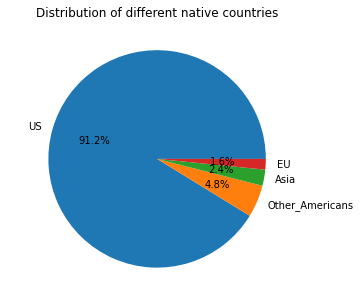

In [50]:
fig, ax = plt.subplots(figsize=(9,5))
df['native_country'].value_counts().plot.pie(autopct='%1.1f%%')
plt.title('Distribution of different native countries')
plt.ylabel(' ')
plt.show()

US                 29153
Other_Americans     1530
Asia                 767
EU                   505
Name: native_country, dtype: int64


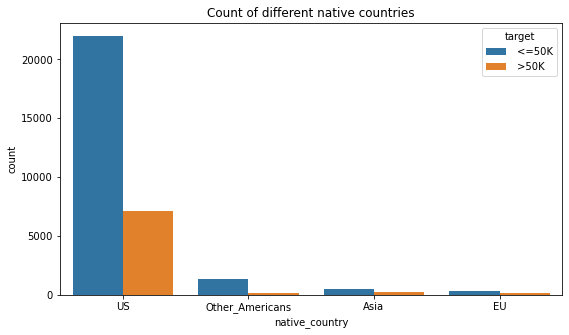

In [64]:
print(df['native_country'].value_counts())

fig, ax = plt.subplots(figsize=(9,5))
sns.countplot(x=df['native_country'], hue=df['target'])
plt.title('Count of different native countries')
plt.show()

### Race and sex

C:\Users\NP950XBE-X01HK\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\NP950XBE-X01HK\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


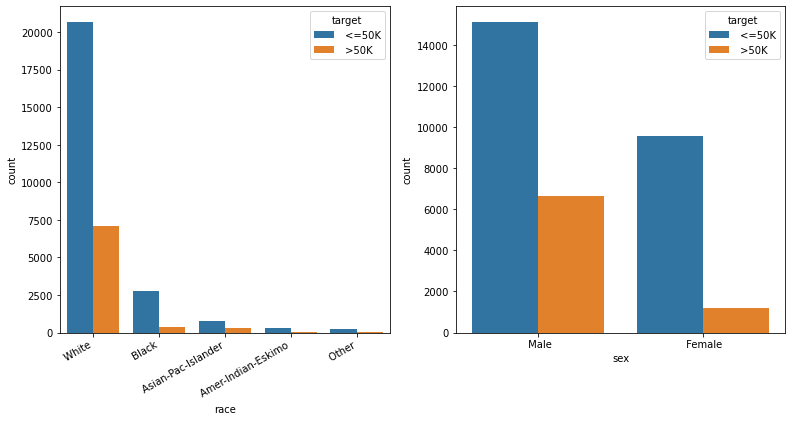

In [89]:
fig, ax = plt.subplots(1,2, figsize=(13,6))
sns.countplot(df['race'], hue=df['target'], ax=ax[0])
sns.countplot(df['sex'], hue=df['target'], ax=ax[1])
ax[0].set_xticklabels(df['race'].unique(), rotation=30, ha='right')
plt.show()

### Age

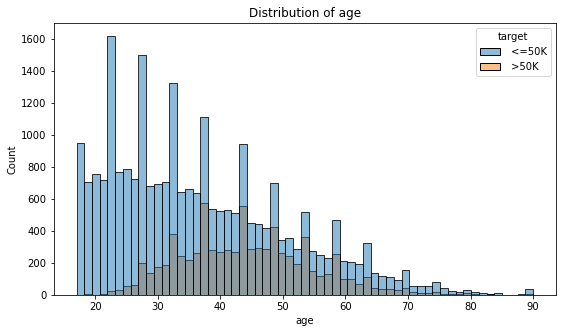

In [55]:
fig, ax = plt.subplots(figsize=(9,5))
sns.histplot(data=df, x='age', hue='target')
plt.title('Distribution of age')
plt.show()

### Final weight

In [28]:
# From the data description, people with similar demographic characteristics should have similar weights. 
# It can treat as a number representing a combined info for other features. 
# Drop it to avoid multicollinearity
df.drop('fnlwgt', axis=1, inplace=True)

### Captial gain / loss

As mentioned at the beginning, there may have outliers in these two columns. Let's further investigate. 

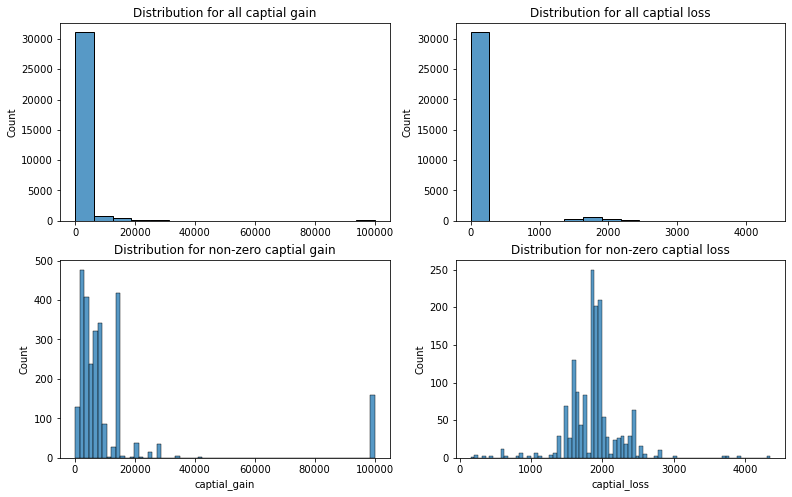

In [56]:
fig, ax = plt.subplots(2,2, figsize=(13,8))
sns.histplot(df['captial_gain'], ax=ax[0,0])
sns.histplot(df[df['captial_gain']>0]['captial_gain'], ax=ax[1,0])
sns.histplot(df['captial_loss'], ax=ax[0,1])
sns.histplot(df[df['captial_loss']>0]['captial_loss'], ax=ax[1,1])
ax[0,0].set_title('Distribution for all captial gain')
ax[1,0].set_title('Distribution for non-zero captial gain')
ax[0,1].set_title('Distribution for all captial loss')
ax[1,1].set_title('Distribution for non-zero captial loss')
ax[0,0].set_xlabel(' ')
ax[0,1].set_xlabel(' ')
plt.show()

In [45]:
print(f"Proportion for zero captial gain: {round(df['captial_gain'].value_counts()[0]/df.shape[0], 2)}")
print(f"Proportion for zero captial loss: {round(df['captial_loss'].value_counts()[0]/df.shape[0], 2)}")

Proportion for zero captial gain: 0.92
Proportion for zero captial loss: 0.95


In [29]:
# The two data are highly skewed to the zero size. 
# Since >90% of data are zero, these features are not useful to differentiate among different instances. 
# Drop these two columns to simplify the situation
df.drop(['captial_gain', 'captial_loss'], axis=1, inplace=True)

### Multicollinearity checking for the continuous variables

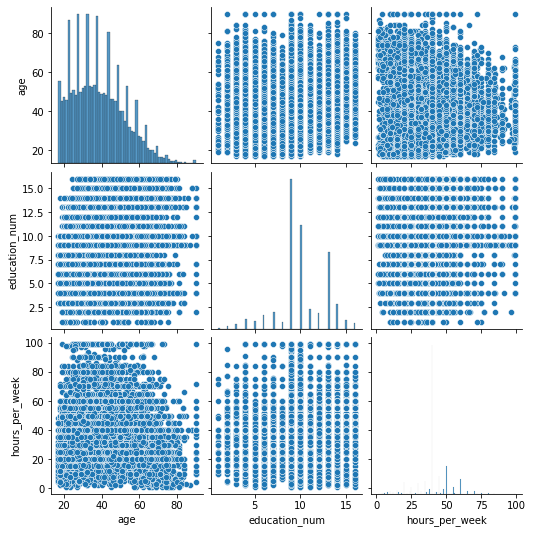

In [58]:
sns.pairplot(df[['age', 'education_num', 'hours_per_week']])

<AxesSubplot:>

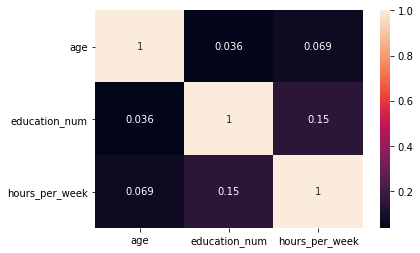

In [61]:
sns.heatmap(df[['age', 'education_num', 'hours_per_week']].corr(), annot=True)

Clearly the three columns are not corelated. 

### Drop the entry with unknown values in any features

Previously the unknown values are assigned as null. Drop them out now.

In [30]:
df.isnull().sum()

age                  0
workclass         1836
education_num        0
marital_status       0
occupation        1843
race                 0
sex                  0
hours_per_week       0
native_country     582
target               0
dtype: int64

In [31]:
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)
df.head()

,age,workclass,education_num,marital_status,occupation,race,sex,hours_per_week,native_country,target
0,39,State-gov,13,Never-married,Adm-clerical,White,Male,40,US,<=50K
1,50,Self-emp-not-inc,13,Married-civ-spouse,Exec-managerial,White,Male,13,US,<=50K
2,38,Private,9,Divorced,Handlers-cleaners,White,Male,40,US,<=50K
3,53,Private,7,Married-civ-spouse,Handlers-cleaners,Black,Male,40,US,<=50K
4,28,Private,13,Married-civ-spouse,Prof-specialty,Black,Female,40,Other_Americans,<=50K


In [32]:
df.shape

(30139, 10)

In [33]:
# Save the cleaned dataset for further use
df.to_csv('cleaned_df.csv')